In [1]:
%load_ext autoreload
%autoreload 2

In [ ]:
import anndata as ad
import numpy as np
import pandas as pd

from rich import print
import os
import scanpy as sc

import scvi

import matplotlib.pyplot as plt
import colorcet as cc
# Set SVG font type to 'none' to keep text as text in SVG files
plt.rcParams["svg.fonttype"] = "none"

from scipy.stats import zscore, wilcoxon

scvi.settings.seed = 34

/home/nathanlevy/mambaforge/envs/scvi/lib/python3.11/site-packages/anndata/utils.py:429: FutureWarning: Importing read_csv from `anndata` is deprecated. Import anndata.io.read_csv instead.
  warnings.warn(msg, FutureWarning)
/home/nathanlevy/mambaforge/envs/scvi/lib/python3.11/site-packages/anndata/utils.py:429: FutureWarning: Importing read_text from `anndata` is deprecated. Import anndata.io.read_text instead.
  warnings.warn(msg, FutureWarning)
/home/nathanlevy/mambaforge/envs/scvi/lib/python3.11/site-packages/anndata/utils.py:429: FutureWarning: Importing read_excel from `anndata` is deprecated. Import anndata.io.read_excel instead.
  warnings.warn(msg, FutureWarning)
/home/nathanlevy/mambaforge/envs/scvi/lib/python3.11/site-packages/anndata/utils.py:429: FutureWarning: Importing read_mtx from `anndata` is deprecated. Import anndata.io.read_mtx instead.
  warnings.warn(msg, FutureWarning)
/home/nathanlevy/mambaforge/envs/scvi/lib/python3.11/site-packages/anndata/utils.py:429: Futur

In [3]:
from params import setup  # , cell_type_color_dict, niche_color_dict, niche_setup

In [4]:
sc.set_figure_params(dpi=150, fontsize=12, format="svg")

figure_dir = setup.FIGURES_FOLDER

plots = True

In [7]:
data_dir, data_file = setup.DATA_FOLDER, setup.DATA_FILE

data_file_name = os.path.splitext(data_file)[0]
print(data_file_name)


path_to_save = os.path.join("../../niche-VI-experiments/checkpoints", data_file_name)
os.makedirs(path_to_save, exist_ok=True)

adata_M1_M2_core_6_sections

In [8]:
# adata = ad.read_h5ad(data_dir + data_file)
adata = ad.read_h5ad(path_to_save + "/adata_M1_M2_core_6_sections_nicheVI.h5ad")

print(adata)

AnnData object with n_obs × n_vars = 250790 × 1122
    obs: 'organism_ontology_term_id', 'donor_id', 'development_stage_ontology_term_id', 'sex_ontology_term_id', 
'self_reported_ethnicity_ontology_term_id', 'disease_ontology_term_id', 'tissue_ontology_term_id', 
'cell_type_ontology_term_id', 'assay_ontology_term_id', 'suspension_type', 'cluster_id_transfer', 
'subclass_transfer', 'cluster_confidence_score', 'subclass_confidence_score', 'high_quality_transfer', 
'major_brain_region', 'ccf_region_name', 'brain_section_label', 'tissue_type', 'is_primary_data', 'cell_type', 
'assay', 'disease', 'organism', 'sex', 'tissue', 'self_reported_ethnicity', 'development_stage', 
'observation_joinid', 'n_counts', 'batch', '_scvi_batch', '_scvi_labels', 'n_genes_by_counts', 
'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 
'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 
'log1p_total_counts_mt', 'pct_counts_mt', '_indices', '_scvi_ind_x', 'major_brain_region_banksy_astrocyte', 
'major_brain_region_banksy_endothelial', 'major_brain_region_banksy_oligodendrocyte_precursor', 
'major_brain_region_banksy_microglial', 'major_brain_region_banksy_pericyte', 
'major_brain_region_banksy_oligodendrocyte', 'major_brain_region_banksy_glutamatergic', 
'major_brain_region_banksy_GABAergic', 'cell_type_niche', 'index', '_scvi_sample'
    var: 'gene_name', 'feature_is_filtered', 'feature_name', 'feature_reference', 'feature_biotype', 
'feature_length', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 
'total_counts', 'log1p_total_counts'
    uns: '_scvi_manager_uuid', '_scvi_uuid', 'log1p', 'pca', 'simvi_train_mask', 'simvi_train_mask_06', 
'simvi_train_mask_08', 'simvi_val_mask', 'simvi_val_mask_06', 'simvi_val_mask_08'
    obsm: 'X_CCF', 'X_banksy_02_harmony_GABAergic', 'X_banksy_02_harmony_astrocyte', 
'X_banksy_02_harmony_endothelial', 'X_banksy_02_harmony_glutamatergic', 'X_banksy_02_harmony_microglial', 
'X_banksy_02_harmony_oligodendrocyte', 'X_banksy_02_harmony_oligodendrocyte_precursor', 
'X_banksy_02_harmony_pericyte', 'X_nicheformer', 'X_nicheformer_e1', 'X_nicheformer_e5', 'X_pca', 'X_resolvi', 
'X_resolvi_MDE', 'X_scanvi', 'X_spatial', 'X_umap', 'banksy_pc_20_lambda_0.0', 'banksy_pc_20_lambda_0.0_GABAergic',
'banksy_pc_20_lambda_0.0_astrocyte', 'banksy_pc_20_lambda_0.0_endothelial', 
'banksy_pc_20_lambda_0.0_glutamatergic', 'banksy_pc_20_lambda_0.0_microglial', 
'banksy_pc_20_lambda_0.0_oligodendrocyte', 'banksy_pc_20_lambda_0.0_oligodendrocyte_precursor', 
'banksy_pc_20_lambda_0.0_pericyte', 'banksy_pc_20_lambda_0.2', 'banksy_pc_20_lambda_0.2_GABAergic', 
'banksy_pc_20_lambda_0.2_astrocyte', 'banksy_pc_20_lambda_0.2_endothelial', 
'banksy_pc_20_lambda_0.2_glutamatergic', 'banksy_pc_20_lambda_0.2_microglial', 
'banksy_pc_20_lambda_0.2_oligodendrocyte', 'banksy_pc_20_lambda_0.2_oligodendrocyte_precursor', 
'banksy_pc_20_lambda_0.2_pericyte', 'banksy_pc_20_lambda_0.4', 'banksy_pc_20_lambda_0.4_astrocyte', 
'banksy_pc_20_lambda_0.5', 'banksy_pc_20_lambda_0.6', 'distance_neighbor', 'index_neighbor', 
'neighborhood_composition', 'niche_distances', 'niche_indexes', 'qz1_m', 'qz1_m_niche_ct', 
's10_scanvi_lr0.0005_poisson_X_nicheVI', 'simvi_both', 'simvi_both_06', 'simvi_both_07', 'simvi_both_08', 
'simvi_both_MDE', 'simvi_both_MDE_06', 'simvi_both_MDE_07', 'simvi_both_MDE_08', 'simvi_interact', 
'simvi_interact_06', 'simvi_interact_07', 'simvi_interact_08', 'simvi_interact_MDE', 'simvi_interact_MDE_06', 
'simvi_interact_MDE_07', 'simvi_interact_MDE_08', 'simvi_intrinsic', 'simvi_intrinsic_06', 'simvi_intrinsic_07', 
'simvi_intrinsic_08', 'simvi_intrinsic_MDE', 'simvi_intrinsic_MDE_06', 'simvi_intrinsic_MDE_07', 
'simvi_intrinsic_MDE_08', 'spatial'
    varm: 'PCs'
    layers: 'counts'

In [7]:
# adata = ad.read_h5ad(data_dir + data_file)
# adata

In [10]:
adata_nf_e1 =  ad.read_h5ad('/home/nathanlevy/sda/nicheformer/notebooks/experiments/data_with_embeddings_epoch=00.h5ad')
adata_nf_e5 =  ad.read_h5ad('/home/nathanlevy/sda/nicheformer/notebooks/experiments/data_with_embeddings_epoch=04.h5ad')

In [12]:
adata.obsm['X_nicheformer_e1']  = adata_nf_e1.obsm['X_niche_embeddings'].copy()
adata.obsm['X_nicheformer_e5']  = adata_nf_e5.obsm['X_niche_embeddings'].copy()

adata.write_h5ad(path_to_save + "/adata_M1_M2_core_6_sections_nicheVI.h5ad")

In [9]:
# adata_astro.layers["standard_scaled"] = adata_astro.X.copy()
# sc.pp.scale(adata_astro, max_value=None, layer="standard_scaled")

from sklearn.preprocessing import MinMaxScaler

adata.layers["counts_log1p"] = adata.layers["counts"].copy()
sc.pp.log1p(adata, layer="counts_log1p")

adata.layers["standard_scaled"] = adata.layers["counts_log1p"].copy()
sc.pp.scale(adata, max_value=None, layer="standard_scaled")

adata.layers["min_max_scaled"] = MinMaxScaler().fit_transform(
    adata.layers["counts_log1p"].toarray()
)

adata.layers['min_max_scaled_raw'] = MinMaxScaler().fit_transform(adata.layers['counts'].toarray())

In [23]:
adata.obs[setup.CELL_TYPE].value_counts()

cell_type
glutamatergic neuron              89669
oligodendrocyte                   40406
GABAergic neuron                  35772
astrocyte                         29856
endothelial cell                  23083
microglial cell                    8712
oligodendrocyte_precursor cell     6898
pericyte                           5359
vascular leptomeningeal cell       2660
ependymal cell                     2399
choroid plexus epithelial cell     1659
smooth muscle cell                 1411
neuroblast (sensu Vertebrata)      1170
macrophage                          909
tanycyte                            512
lymphocyte                          216
dopaminergic neuron                  99
Name: count, dtype: int64

In [9]:
adata.obs[setup.NICHE][adata.obs[setup.CELL_TYPE] == "astrocyte"].value_counts()

major_brain_region
Isocortex              7015
Thalamus               5117
Hypothalamus           3896
Fiber_tracts           3715
Striatum               3459
Hippocampus            2251
Olfactory              1787
Cortical_subplate      1092
Pallidum                978
Ventricular_systems     546
Name: count, dtype: int64

In [15]:
# adata_oligo = ad.read_h5ad(
#     os.path.join(path_to_save + "/adata_M1_M2_core_6_sections_nicheVI_oligodendrocyte.h5ad")
# )[:, oligo_lfc2_markers]
# print(adata_oligo)

adata_astro = ad.read_h5ad(
    os.path.join(path_to_save + "/adata_M1_M2_core_6_sections_nicheVI_astrocyte.h5ad")
)
# [:, astro_lfc2_markers]
print(adata_astro)

AnnData object with n_obs × n_vars = 29856 × 1122
    obs: 'organism_ontology_term_id', 'donor_id', 'development_stage_ontology_term_id', 'sex_ontology_term_id', 
'self_reported_ethnicity_ontology_term_id', 'disease_ontology_term_id', 'tissue_ontology_term_id', 
'cell_type_ontology_term_id', 'assay_ontology_term_id', 'suspension_type', 'cluster_id_transfer', 
'subclass_transfer', 'cluster_confidence_score', 'subclass_confidence_score', 'high_quality_transfer', 
'major_brain_region', 'ccf_region_name', 'brain_section_label', 'tissue_type', 'is_primary_data', 'cell_type', 
'assay', 'disease', 'organism', 'sex', 'tissue', 'self_reported_ethnicity', 'development_stage', 
'observation_joinid', 'n_counts', 'batch', '_scvi_batch', '_scvi_labels', 'n_genes_by_counts', 
'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 
'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 
'log1p_total_counts_mt', 'pct_counts_mt', '_indices', '_scvi_ind_x', 'major_brain_region_banksy_astrocyte', 
'major_brain_region_banksy_endothelial', 'major_brain_region_banksy_oligodendrocyte_precursor', 
'major_brain_region_banksy_microglial', 'major_brain_region_banksy_pericyte', 
'major_brain_region_banksy_oligodendrocyte', 'major_brain_region_banksy_glutamatergic', 
'major_brain_region_banksy_GABAergic', 'cell_type_niche', 'index', '_scvi_sample', 'leiden_scvi', 'leiden_simvi', 
'leiden_nichevi', 'leiden_banksy_02', 'Module 1', 'Module 2', 'Module 3', 'Module 4', 'Module 5', 'Module 6', 
'Module 7', 'Module 8', 'Module 9', 'Module 10', 'Module 11', 'Module 12', 'Module 13', 'Module 14', 'Module 15', 
'Module 16'
    var: 'gene_name', 'feature_is_filtered', 'feature_name', 'feature_reference', 'feature_biotype', 
'feature_length', 'mt', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 
'total_counts', 'log1p_total_counts'
    uns: '_scvi_manager_uuid', '_scvi_uuid', 'leiden', 'leiden_banksy_02_colors', 'leiden_nichevi_colors', 
'leiden_scvi_colors', 'leiden_simvi_colors', 'major_brain_region_colors', 'module_autoc_X_scanvi', 
'module_autoc_s10_scanvi_lr0.0005_poisson_X_nicheVI', 'neighbors', 'pca', 'results_X_scanvi', 
'results_s10_scanvi_lr0.0005_poisson_X_nicheVI', 'simvi_train_mask', 'simvi_train_mask_06', 'simvi_train_mask_08', 
'simvi_val_mask', 'simvi_val_mask_06', 'simvi_val_mask_08', 'umap'
    obsm: 'X_CCF', 'X_banksy_02_harmony', 'X_banksy_02_harmony_GABAergic', 'X_banksy_02_harmony_astrocyte', 
'X_banksy_02_harmony_endothelial', 'X_banksy_02_harmony_glutamatergic', 'X_banksy_02_harmony_microglial', 
'X_banksy_02_harmony_oligodendrocyte', 'X_banksy_02_harmony_oligodendrocyte_precursor', 
'X_banksy_02_harmony_pericyte', 'X_pca', 'X_resolvi', 'X_resolvi_MDE', 'X_scanvi', 'X_spatial', 'X_umap', 
'banksy_pc_20_lambda_0.0', 'banksy_pc_20_lambda_0.0_GABAergic', 'banksy_pc_20_lambda_0.0_astrocyte', 
'banksy_pc_20_lambda_0.0_endothelial', 'banksy_pc_20_lambda_0.0_glutamatergic', 
'banksy_pc_20_lambda_0.0_microglial', 'banksy_pc_20_lambda_0.0_oligodendrocyte', 
'banksy_pc_20_lambda_0.0_oligodendrocyte_precursor', 'banksy_pc_20_lambda_0.0_pericyte', 'banksy_pc_20_lambda_0.2',
'banksy_pc_20_lambda_0.2_GABAergic', 'banksy_pc_20_lambda_0.2_astrocyte', 'banksy_pc_20_lambda_0.2_endothelial', 
'banksy_pc_20_lambda_0.2_glutamatergic', 'banksy_pc_20_lambda_0.2_microglial', 
'banksy_pc_20_lambda_0.2_oligodendrocyte', 'banksy_pc_20_lambda_0.2_oligodendrocyte_precursor', 
'banksy_pc_20_lambda_0.2_pericyte', 'banksy_pc_20_lambda_0.4', 'banksy_pc_20_lambda_0.4_astrocyte', 
'banksy_pc_20_lambda_0.5', 'banksy_pc_20_lambda_0.6', 'distance_neighbor', 'index_neighbor', 
'modules_scoresX_scanvi', 'modules_scoress10_scanvi_lr0.0005_poisson_X_nicheVI', 
'mog_s20_w400_scanvi_lr0.0005_poisson_X_nicheVI', 'neighborhood_composition', 'niche_distances', 'niche_indexes', 
'qz1_m', 'qz1_m_niche_ct', 's10_scanvi_lr0.0005_poisson_X_nicheVI', 'simvi_both', 's

Hypothalamus astrocyte banksy  = 2

Thalamus astrocyte banksy  = 0

Fiber tracts astrocyte banksy  = 4

/home/nathanlevy/mambaforge/envs/scvi/lib/python3.11/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/nathanlevy/mambaforge/envs/scvi/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


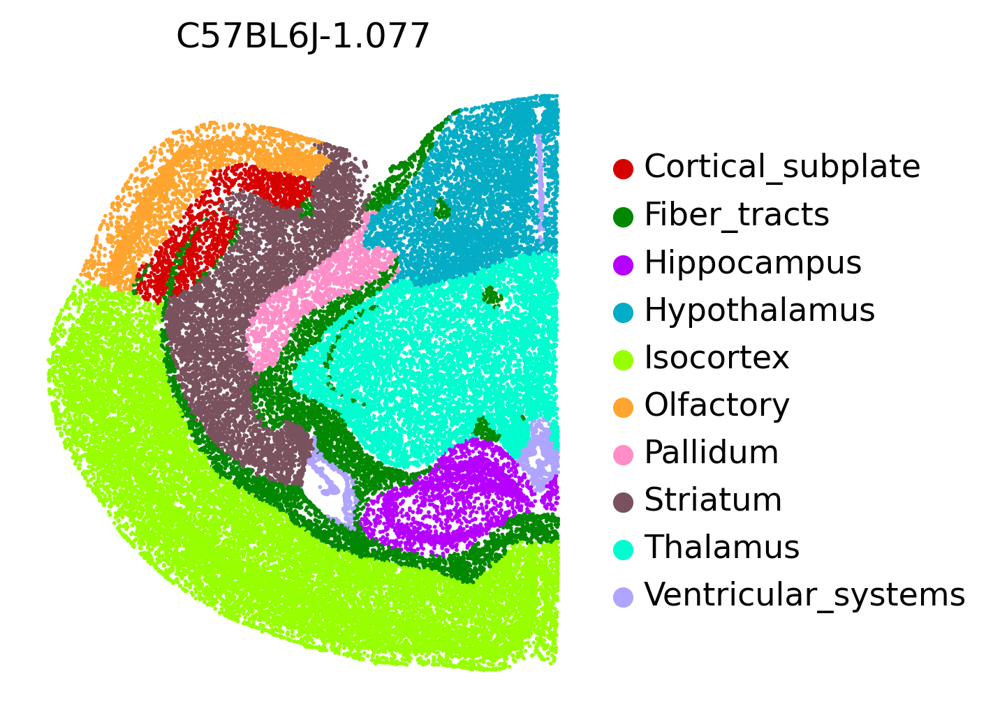

In [13]:
for sample in adata.obs[setup.SAMPLE].unique().tolist()[1:2]:
    sc.pl.spatial(
        adata[adata.obs[setup.SAMPLE] == sample],
        spot_size=40,
        color=[setup.NICHE],
        # color=[setup.CELL_TYPE],
        ncols=1,
        frameon=False,
        title=sample,
        # palette="tab10",
        palette = cc.glasbey_light,
        show=False,
    )

#     plt.savefig(f"{figure_dir}brain_section_niche.png", bbox_inches="tight", dpi=1000)
#     plt.savefig(f"{figure_dir}brain_section_niche.svg", bbox_inches="tight", dpi=1000)

# Hotspot 

In [16]:
adata_astro

AnnData object with n_obs × n_vars = 29856 × 1122
    obs: 'organism_ontology_term_id', 'donor_id', 'development_stage_ontology_term_id', 'sex_ontology_term_id', 'self_reported_ethnicity_ontology_term_id', 'disease_ontology_term_id', 'tissue_ontology_term_id', 'cell_type_ontology_term_id', 'assay_ontology_term_id', 'suspension_type', 'cluster_id_transfer', 'subclass_transfer', 'cluster_confidence_score', 'subclass_confidence_score', 'high_quality_transfer', 'major_brain_region', 'ccf_region_name', 'brain_section_label', 'tissue_type', 'is_primary_data', 'cell_type', 'assay', 'disease', 'organism', 'sex', 'tissue', 'self_reported_ethnicity', 'development_stage', 'observation_joinid', 'n_counts', 'batch', '_scvi_batch', '_scvi_labels', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pc

In [17]:
latent_obsm_key = "s10_scanvi_lr0.0005_poisson_X_nicheVI"
# latent_obsm_key = "X_scanvi"
# latent_obsm_key = "spatial"

In [24]:
import hotspot

adata_astro.layers["counts_csc"] = adata_astro.layers["counts"].tocsc()
hs = hotspot.Hotspot(
    adata_astro,
    layer_key="counts_csc",
    model="danb",
    latent_obsm_key=latent_obsm_key,
    # umi_counts_obs_key="total_counts"
)

hs.create_knn_graph(
    weighted_graph=False,
    n_neighbors=30,
)

hs_results = hs.compute_autocorrelations(jobs=-1)
hs_results.head(15)

adata_astro.uns[f"results_{latent_obsm_key}"] = hs_results.loc[hs_results.FDR < 0.05]

100%|██████████| 1122/1122 [00:03<00:00, 360.24it/s]


In [25]:
# Select the genes with significant lineage autocorrelation
hs_genes = (
    hs_results.loc[hs_results.FDR < 0.05]
    .sort_values("Z", ascending=False)
    .head(500)
    .index
)

# Compute pair-wise local correlations between these genes
lcz = hs.compute_local_correlations(hs_genes, jobs=-1)

modules = hs.create_modules(min_gene_threshold=15, core_only=True, fdr_threshold=0.05)

module_scores = hs.calculate_module_scores()

# Convert all column names to strings
module_scores.columns = module_scores.columns.map(str)


hs.results.join(hs.modules)
adata_astro.obsm[f"modules_scores{latent_obsm_key}"] = module_scores
adata_astro.uns[f"results_{latent_obsm_key}"] = hs_results.join(hs.modules).loc[
    hs_results.FDR < 0.05
]

modules.value_counts()

Computing pair-wise local correlation on 500 features...


100%|██████████| 124750/124750 [03:05<00:00, 671.58it/s]


Computing scores for 14 modules...


100%|██████████| 14/14 [00:02<00:00,  4.77it/s]


Module
 4     60
 1     48
-1     47
 6     45
 7     37
 11    36
 2     31
 10    29
 5     28
 8     25
 9     25
 3     25
 13    24
 12    22
 14    18
Name: count, dtype: int64

In [11]:
module_cols = []
for c in adata_astro.obsm[f"modules_scores{latent_obsm_key}"].columns:
    key = f"Module {c}"
    adata_astro.obs[key] = adata_astro.obsm[f"modules_scores{latent_obsm_key}"][c]
    module_cols.append(key)

In [17]:
# hs.plot_local_correlations(vmin=-12, vmax=12, mod_cmap='tab20')
# plt.savefig(
#     os.path.join(figure_dir, f"local_correlations_hotspot_{latent_obsm_key}.svg"),
#     bbox_inches="tight",
#     dpi=500,
# )
# plt.savefig(
#     os.path.join(figure_dir, f"local_correlations_hotspot_{latent_obsm_key}.png"),
#     bbox_inches="tight",
#     dpi=500,
# )

In [27]:
module_scores.head()

,1,2,3,4,5,6,7,8,9,10,11,12,13,14
10618021078266319649091845116122351158-0,-1.665403,-0.216191,-0.548152,-0.532253,1.174720,0.981805,-0.751912,-0.539195,-0.809423,-0.580361,-0.377625,-0.564022,0.443204,-0.577367
45601326812016068113591765200615301358-0,-2.335836,-0.000895,0.030829,0.651191,1.956347,-0.173248,-0.782126,-0.154822,-0.749997,0.690825,0.037082,-0.609866,0.936263,-0.657067
164200094076825516555967476063811020046-0,-1.808337,-0.568118,0.218214,-0.810195,0.950349,0.442443,-0.786202,-0.350677,-0.903769,-0.389782,-0.215413,-0.658553,0.815039,-0.782639
160645560722755236428007539982648695291-0,-1.815943,-0.418837,0.144799,0.450427,1.156752,-0.368187,-1.144913,-0.419970,-0.698312,-0.075764,-0.300669,-0.913144,1.793327,-0.676588
146760206946501608228722452044210071561-0,-1.180896,-0.223557,-0.485343,-0.254988,1.212626,-0.413289,-0.775248,-0.459768,-0.722112,-0.450110,-0.233425,-0.722807,1.738066,-0.882985


In [19]:
# import pandas as pd
# import seaborn as sns
# import matplotlib.pyplot as plt

# region = adata_astro.obs[setup.NICHE]

# sorted_region = region
# sorted_module_scores = module_scores

# # Create a color palette for your regions
# unique_regions = sorted_region.unique()
# color_palette = sns.color_palette("hls", len(unique_regions))
# region_colors = dict(zip(unique_regions, color_palette))

# # Create a color list for the rows based on regions
# row_colors = [region_colors[region] for region in sorted_region]

# # Create the clustermap
# g = sns.clustermap(
#     sorted_module_scores,
#     z_score=0,
#     col_cluster=True,
#     row_colors=row_colors,
#     figsize=(12, 10),
#     method='weighted',
#     # method='average',
# )

# # Add a legend for regions
# handles = [
#     plt.Rectangle((0, 0), 1, 1, color=region_colors[region])
#     for region in unique_regions
# ]
# plt.legend(
#     handles,
#     unique_regions,
#     title="Region",
#     bbox_to_anchor=(1, 1.15),
#     bbox_transform=plt.gcf().transFigure,
#     loc="upper right",
# )

# # Rotate x-axis labels if needed
# plt.setp(g.ax_heatmap.get_xticklabels(), rotation=45, ha="right")

# # Show the plot
# plt.tight_layout()
# plt.show()

In [20]:
# latent_obsm_key = "scanvi_s10_scanvi_lr0.0001_poisson_X_nicheVI"
# latent_obsm_key = "X_scanvi"


adata_modules = ad.AnnData(zscore(adata_astro.obsm[f"modules_scores{latent_obsm_key}"]))
# adata_modules = ad.AnnData(adata_astro.obsm[f'modules_scores{latent_obsm_key}'])
adata_modules.obs_names = adata_astro.obs.index
adata_modules.var_names = adata_astro.obsm[f"modules_scores{latent_obsm_key}"].columns
adata_modules.obsm["spatial"] = adata_astro.obsm["spatial"]
adata_modules.obsm["X_scanvi"] = adata_astro.obsm["X_scanvi"]
adata_modules.obsm[latent_obsm_key] = adata_astro.obsm[latent_obsm_key]

# maybe

hs_m = hotspot.Hotspot(adata_modules, model="none", latent_obsm_key="spatial")
# hs_m = hotspot.Hotspot(adata_modules, model="none", latent_obsm_key=latent_obsm_key)
hs_m.create_knn_graph(
    weighted_graph=False,
    n_neighbors=30,
)

hs_m_results = hs_m.compute_autocorrelations(jobs=-1)

adata_astro.uns[f"module_autoc_{latent_obsm_key}"] = hs_m_results

adata_astro.uns[f"module_autoc_{latent_obsm_key}"]

100%|██████████| 14/14 [00:00<00:00, 114.43it/s]


,C,Z,Pval,FDR
Gene,,,,
5,0.894637,620.685814,0.000000e+00,0.000000e+00
1,0.798565,550.522443,0.000000e+00,0.000000e+00
14,0.748974,520.027084,0.000000e+00,0.000000e+00
4,0.723358,498.386818,0.000000e+00,0.000000e+00
7,0.678936,492.084711,0.000000e+00,0.000000e+00
6,0.519939,351.553825,0.000000e+00,0.000000e+00
13,0.481907,331.822120,0.000000e+00,0.000000e+00
10,0.474322,326.558483,0.000000e+00,0.000000e+00
11,0.456499,313.735910,0.000000e+00,0.000000e+00


In [54]:
# nichevi_modules = {'5': 'Hypothalamus', '4': "Thalamus", '8': "Striatum", '3': "Fiber_tracts"}
# nichevi_modules = {
#     "5": "Hypothalamus",
#     "4": "Thalamus",
#     "8": "Striatum",
#     "3": "Fiber_tracts",
#     "6": "fb2",
#     "12": "cortex",
#     "11": "hypo2",
#     "7": "ventricular",
# }

nichevi_modules = {
    "5": "Hypothalamus",
    "4": "Thalamus",
    "11": "Striatum",
    "3": "Fiber_tracts",
    "7": "fb2",
    "12": "cortex",
    "10": "hypo2",
    "6": "ventricular",
}

scanvi_modules = {
    "4": "Hypothalamus",
    "7": "Thalamus",
    "10": "Striatum",
    "3": "Fiber_tracts",
    "5": "fb2",
    "11": "cortex",
    "12": "hypo2",
    "6": "ventricular",
}


MODEL = "s10_scanvi_lr0.0005_poisson"

spatial_module_scores_nichevi = [
    adata_astro.uns[f"module_autoc_{MODEL}_X_nicheVI"]["C"].loc[key]
    for key in nichevi_modules.keys()
]
spatial_module_scores_scanvi = [
    adata_astro.uns["module_autoc_X_scanvi"]["C"].loc[key]
    for key in scanvi_modules.keys()
]

print(spatial_module_scores_nichevi)
print(spatial_module_scores_scanvi)

wilcoxon(
    spatial_module_scores_nichevi[:],
    spatial_module_scores_scanvi[:],
    alternative="greater",
)

[
    0.8946373340556564,
    0.7233575396016801,
    0.4564993649978759,
    0.28462741883022463,
    0.6789357909335988,
    0.3941965962487469,
    0.4743218644617916,
    0.5199392678288979
]

[
    0.8712011312754787,
    0.6507851926082077,
    0.3888799871637954,
    0.18793393905784214,
    0.6557869769332266,
    0.369642305422984,
    0.45965615970069806,
    0.48599902987826743
]

WilcoxonResult(statistic=36.0, pvalue=0.00390625)

In [55]:
# Use pandas.get_dummies to convert the categorical column to binary columns
niche_dummies = pd.get_dummies(adata_astro.obs[setup.NICHE], prefix=setup.NICHE)
niche_dummies.head()

,major_brain_region_Cortical_subplate,major_brain_region_Fiber_tracts,major_brain_region_Hippocampus,major_brain_region_Hypothalamus,major_brain_region_Isocortex,major_brain_region_Olfactory,major_brain_region_Pallidum,major_brain_region_Striatum,major_brain_region_Thalamus,major_brain_region_Ventricular_systems
10618021078266319649091845116122351158-0,False,False,False,False,False,False,True,False,False,False
45601326812016068113591765200615301358-0,False,False,False,False,False,False,True,False,False,False
164200094076825516555967476063811020046-0,False,False,False,False,False,False,True,False,False,False
160645560722755236428007539982648695291-0,False,False,False,False,False,False,True,False,False,False
146760206946501608228722452044210071561-0,False,False,False,False,False,False,True,False,False,False


In [43]:
# Iterate over the values of both dictionaries and extract keys for matching values
key_pairs = [
    (value1, key1, key2)
    for key1, value1 in nichevi_modules.items()
    for key2, value2 in scanvi_modules.items()
    if value1 == value2
]

# Convert to a more accessible format, like a dictionary:
matching_keys = {value1: (key1, key2) for value1, key1, key2 in key_pairs}

print("Matching keys:")
print(matching_keys)

Matching keys:

{
    'Hypothalamus': ('5', '4'),
    'Thalamus': ('4', '7'),
    'Striatum': ('11', '10'),
    'Fiber_tracts': ('3', '3'),
    'fb2': ('7', '5'),
    'cortex': ('12', '11'),
    'hypo2': ('10', '12'),
    'ventricular': ('6', '6')
}

In [51]:
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc

auc_scanvi = pd.DataFrame()
auc_nichevi = pd.DataFrame()

for regions, modules in matching_keys.items(): 
    m_nichevi, m_scanvi = modules
    # Replace these with your actual scores
    score_A = adata_astro.obsm[f"modules_scores{MODEL}_X_nicheVI"][m_nichevi]
    score_B = adata_astro.obsm["modules_scoresX_scanvi"][m_scanvi]

    # Compute ROC curve and ROC area for each class
    list_dummies_results_scanvi = []
    list_dummies_results_nichevi = []    
    for region_column in niche_dummies.columns:
        #nichevi
        fpr_nichevi, tpr_nichevi, _ = roc_curve(niche_dummies[region_column], score_A)
        roc_auc_nichevi = auc(fpr_nichevi, tpr_nichevi)
        list_dummies_results_nichevi.append(roc_auc_nichevi)

        #scanvi
        fpr_scanvi, tpr_scanvi, _ = roc_curve(niche_dummies[region_column], score_B)
        roc_auc_scanvi = auc(fpr_scanvi, tpr_scanvi)
        list_dummies_results_scanvi.append(roc_auc_scanvi)
    auc_scanvi[m_scanvi] = list_dummies_results_scanvi
    auc_nichevi[m_nichevi] = list_dummies_results_nichevi

auc_scanvi.index = niche_dummies.columns
auc_nichevi.index = niche_dummies.columns

In [78]:
auc_nichevi

,5,4,11,3,7,12,10,6
major_brain_region_Cortical_subplate,0.427742,0.229472,0.607246,0.251961,0.558411,0.687802,0.446428,0.264800
major_brain_region_Fiber_tracts,0.372957,0.289243,0.447827,0.820909,0.791199,0.314941,0.409929,0.836713
major_brain_region_Hippocampus,0.201162,0.383603,0.604105,0.504138,0.599303,0.561146,0.301446,0.717020
major_brain_region_Hypothalamus,0.957935,0.651058,0.355731,0.413280,0.249529,0.259816,0.920139,0.502808
major_brain_region_Isocortex,0.206669,0.416483,0.488142,0.324930,0.532105,0.867843,0.284883,0.271694
major_brain_region_Olfactory,0.356817,0.300420,0.524859,0.307299,0.688075,0.641898,0.460533,0.441247
major_brain_region_Pallidum,0.739160,0.582192,0.497160,0.750873,0.269351,0.197741,0.632689,0.716654
major_brain_region_Striatum,0.465975,0.294126,0.786744,0.440081,0.608613,0.496589,0.667261,0.350692
major_brain_region_Thalamus,0.787378,0.973251,0.374248,0.644520,0.229595,0.322094,0.473876,0.515418
major_brain_region_Ventricular_systems,0.563519,0.554993,0.518174,0.684214,0.831021,0.367383,0.563113,0.875520


In [83]:
diff_auc = auc_nichevi.max(axis=0).values - auc_scanvi.max(axis=0).values
diff_modules = [
    spatial_module_scores_nichevi[i] - spatial_module_scores_scanvi[i] for i in range(8)
]

In [86]:
from scipy.stats import rankdata

ranks_auc = rankdata(diff_auc)
ranks_modules = rankdata(diff_modules)

rank_match = np.array_equal(ranks_auc, ranks_modules)
ranks_auc

array([4., 5., 8., 6., 7., 1., 2., 3.])

In [87]:
ranks_modules

array([3., 7., 6., 8., 2., 4., 1., 5.])

In [82]:
wilcoxon(
    # auc_nichevi[["5", "4", "11"]].max(axis=0),
    # auc_scanvi[["4", "7", "10"]].max(axis=0),
    auc_nichevi.max(axis=0),
    auc_scanvi.max(axis=0),
    alternative="greater",
)

WilcoxonResult(statistic=36.0, pvalue=0.00390625)

In [16]:
import matplotlib.pyplot as plt
from sklearn.metrics import roc_curve, auc

REGION = "major_brain_region_Thalamus"

y_true = niche_dummies[REGION]

# Replace these with your actual scores
score_A = adata_astro.obsm[f"modules_scores{MODEL}_X_nicheVI"]["4"]
score_B = adata_astro.obsm["modules_scoresX_scanvi"]["7"]

# Calculate ROC curve and AUC for score A
fpr_A, tpr_A, _ = roc_curve(y_true, score_A)
roc_auc_A = auc(fpr_A, tpr_A)

# Calculate ROC curve and AUC for score B
fpr_B, tpr_B, _ = roc_curve(y_true, score_B)
roc_auc_B = auc(fpr_B, tpr_B)

# # Plot the ROC curves
# plt.figure(figsize=(8, 6))
# plt.plot(
#     fpr_A, tpr_A, color="blue", lw=2, label=f"ROC curve nicheVI (area = {roc_auc_A:.2f})"
# )
# plt.plot(
#     fpr_B, tpr_B, color="green", lw=2, label=f"ROC curve scANVI (area = {roc_auc_B:.2f})"
# )

# # Plot the diagonal line for random guessing
# plt.plot([0, 1], [0, 1], color="gray", linestyle="--")

# # Customize the plot
# plt.xlim([0.0, 1.0])
# plt.ylim([0.0, 1.05])
# plt.xlabel("False Positive Rate")
# plt.ylabel("True Positive Rate")
# plt.title(f"ROC Curve for {REGION}")
# plt.legend(loc="lower right")
# plt.grid(alpha=0.3)
# plt.show()
print(f"scanvi: {roc_auc_B:.2f}", f"nichevi: {roc_auc_A:.2f}")

scanvi: 0.96 nichevi: 0.97

In [57]:
adata_astro.write_h5ad(
    os.path.join(path_to_save + "/adata_M1_M2_core_6_sections_nicheVI_astrocyte.h5ad")
)

In [51]:
# df1 = adata_astro.uns["results_X_scanvi"]
# df2 = adata_astro.uns["results_scanvi_s10_scanvi_lr0.0001_poisson_X_nicheVI"]
# df3 = adata_astro.uns["results_spatial"]

# common_genes = df1.index.intersection(df2.index).intersection(df3.index)

# df1_filtered = df1.loc[common_genes]
# df2_filtered = df2.loc[common_genes]
# df3_filtered = df3.loc[common_genes]
# df3_filtered["C_diff"] = df2_filtered["C"] - df1_filtered["C"]
# # df3_filtered["C_diff_rel"] = (df2_filtered["C"] - df1_filtered["C"]) / (df3_filtered["C"])

In [52]:
# # Filter rows where 'Module' is 5
# df_filtered_scanvi = df1[df1["Module"] == 4].nlargest(20, "C")
# df_filtered_nichevi = df2[df2["Module"] == 5].nlargest(20, "C")

# # Get the indexes of both DataFrames
# indexes_df1 = df_filtered_scanvi.index
# indexes_df2 = df_filtered_nichevi.index

# # Find the indexes that are in df2 but not in df1
# indexes_in_df2_not_in_df1 = indexes_df2.difference(indexes_df1)

# # Find the indexes that are in df1 but not in df2
# indexes_in_df1_not_in_df2 = indexes_df1.difference(indexes_df2)

# # Display the result
# print("Indexes present in nichevi but not in scanvi:")
# print(indexes_in_df2_not_in_df1)

# print("Indexes present in scanvi but not in nichevi:")
# print(indexes_in_df1_not_in_df2)

In [53]:
# df_filtered_scanvi

In [54]:
# df_filtered_nichevi.index

In [64]:
# df3_filtered[(df3_filtered["C_diff"] > 0.01) & (df3_filtered["C"] > 0.1)].sort_values(
#     "C_diff", ascending=False
# ).index.tolist()

In [55]:
# indices_4_5 = df2_filtered[
#     (df2_filtered["Module"] == 4) | (df2_filtered["Module"] == 5)
# ].index

In [56]:
# wilcoxon(
#     df2_filtered["C"].loc[indices_4_5],
#     df1_filtered["C"].loc[indices_4_5],
#     alternative="greater",
# )

In [27]:
latent_obsm_key

'X_scanvi'

In [28]:
sc.pp.neighbors(adata_astro, use_rep=latent_obsm_key)
sc.tl.umap(adata_astro, min_dist=0.3)

/home/nathanlevy/mambaforge/envs/scvi/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/nathanlevy/mambaforge/envs/scvi/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


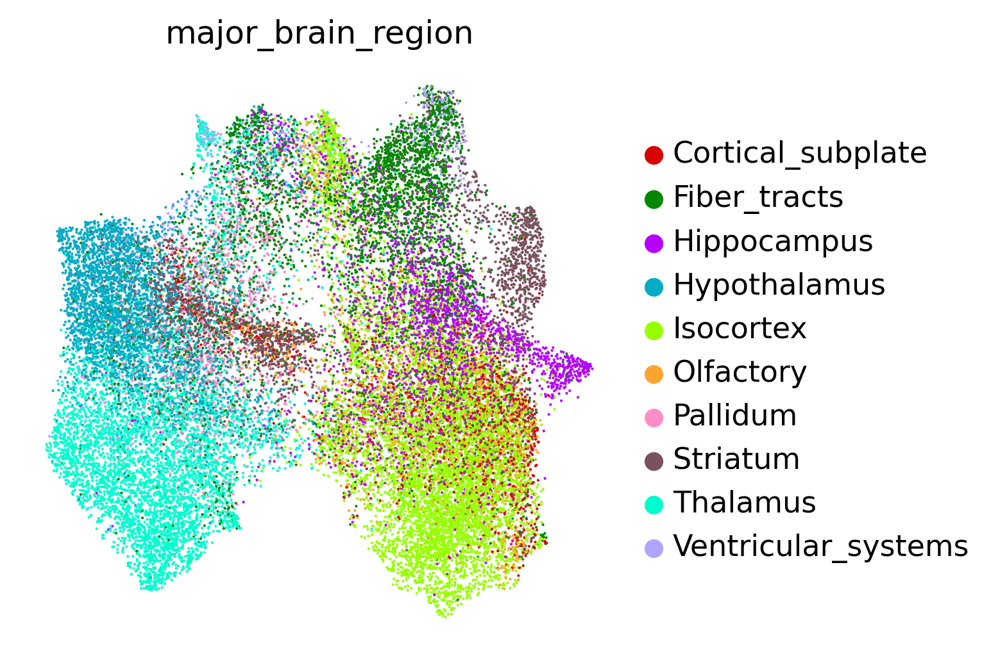

In [29]:
sc.pl.umap(
    adata_astro,
    color=[setup.NICHE],
    # groups = ['Hippocampus', 'Thalamus', 'Striatum'],
    frameon=False,
    vmin=-1,
    vmax=1,
    wspace=0.4,
    show=False,
    # palette="tab20",
    palette = cc.glasbey_light,

)
plt.savefig(
    os.path.join(figure_dir, f"umap_astro_region_{latent_obsm_key}.svg"),
    bbox_inches="tight",
    dpi=500,
)
plt.savefig(
    os.path.join(figure_dir, f"umap_astro_region_{latent_obsm_key}.png"),
    bbox_inches="tight",
    dpi=500,
)

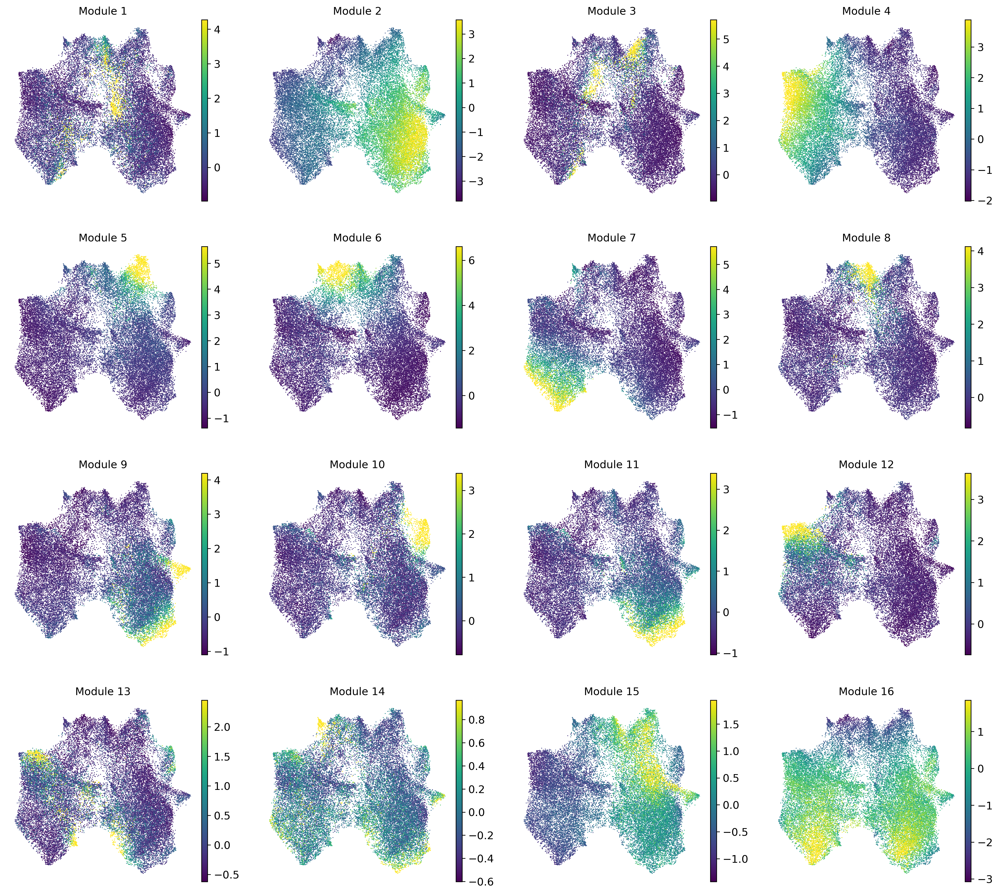

In [33]:
sc.pl.umap(
    adata_astro,
    # color=["Module 4", "Module 5", "Module 11"],
    color=module_cols,
    frameon=False,
    # vmin=-1,
    # vmax=4.,
    vmax='p98',
    wspace=0.2,
    palette=cc.glasbey_light,
    show=False,
    # palette="tab20",
)
# sc.pl.umap(
#     adata_astro,
#     color=[setup.NICHE],
#     frameon=False,
#     vmin=-1,
#     vmax="p96",
#     wspace=0.4,
#     palette=cc.glasbey_light,
#     groups = ['Cortical_subplate', 'Fiber_tracts'],
# )
plt.savefig(
    os.path.join(figure_dir, f"umap_astro_modules_all_{latent_obsm_key}.svg"),
    bbox_inches="tight",
    dpi=500,
)
plt.savefig(
    os.path.join(figure_dir, f"umap_astro_modules_all_{latent_obsm_key}.png"),
    bbox_inches="tight",
    dpi=500,
)

/home/nathanlevy/mambaforge/envs/scvi/lib/python3.11/site-packages/scanpy/plotting/_utils.py:430: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[value_to_plot + '_colors'] = colors_list
/home/nathanlevy/mambaforge/envs/scvi/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1217: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


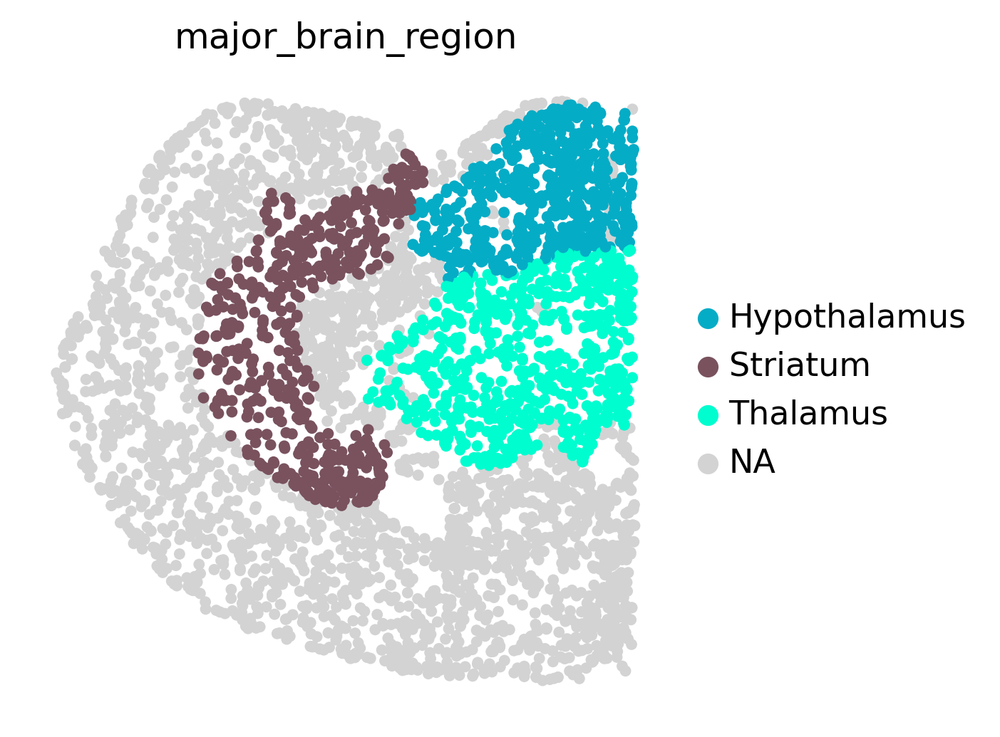

In [13]:
for sample in adata_astro.obs[setup.SAMPLE].unique().tolist()[:1]:
    sc.pl.spatial(
        adata_astro[adata_astro.obs[setup.SAMPLE] == sample],
        spot_size=100,
        color=[setup.NICHE],
        groups=["Hypothalamus", "Thalamus", "Striatum"],
        ncols=4,
        frameon=False,
        # title="astrocyte",
        # palette="tab20",
        palette=cc.glasbey_light,
        show=False,
        use_raw=False,
        wspace=0.4,
        # vmax="p96",
    )
    plt.savefig(
            os.path.join(
                figure_dir, f"spatial_astrocyte_3_regions.svg"
            ),
            bbox_inches="tight",
            dpi=500,
        )
    plt.savefig(
            os.path.join(
                figure_dir, f"spatial_astrocyte_3_regions.png"
            ),
            bbox_inches="tight",
            dpi=500,
        )

In [14]:
# for sample in adata.obs[setup.SAMPLE].unique().tolist()[:1]:
#     # for niche in adata.obs[setup.NICHE].unique().tolist()[:]:
#     for niche in ['Hypothalamus', 'Thalamus', 'Striatum']:
#         sc.pl.spatial(
#             adata_astro[adata_astro.obs[setup.SAMPLE] == sample],
#             spot_size=100,
#             color=[setup.NICHE],
#             groups=[niche],
#             ncols=4,
#             frameon=False,
#             # title="astrocyte",
#             # palette="tab20",
#             palette=cc.glasbey_light,
#             show=False,
#             use_raw=False,
#             wspace=0.4,
#             # vmax="p96",
#         )
#         plt.savefig(
#             os.path.join(
#                 figure_dir, f"spatial_astrocyte_{niche}.svg"
#             ),
#             bbox_inches="tight",
#             dpi=500,
#         )
#         plt.savefig(
#             os.path.join(
#                 figure_dir, f"spatial_astrocyte_{niche}.png"
#             ),
#             bbox_inches="tight",
#             dpi=500,
#         )

/tmp/ipykernel_2173373/1247395697.py:29: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


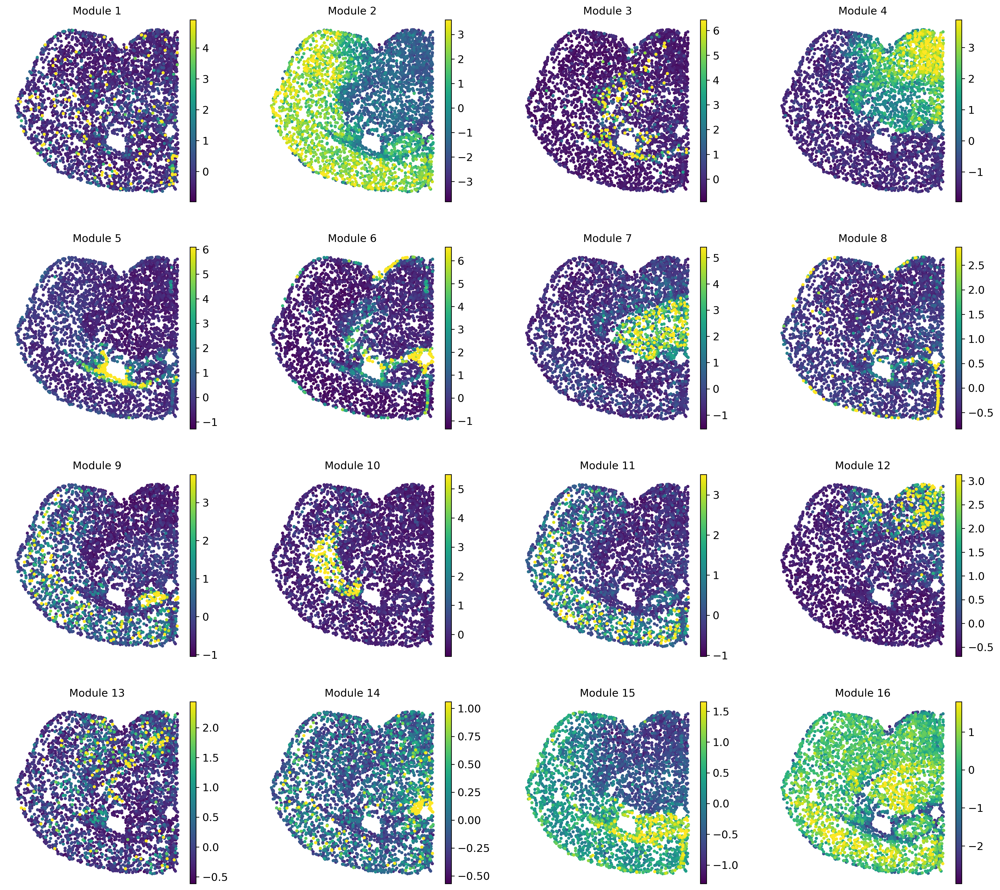

<Figure size 600x600 with 0 Axes>

In [34]:
import matplotlib.pyplot as plt

# Loop through each sample to generate spatial plots
for sample in adata.obs[setup.SAMPLE].unique().tolist()[:1]:
    # Create spatial plot
    sc.pl.spatial(
        adata_astro[adata_astro.obs[setup.SAMPLE] == sample],
        spot_size=100,
        color=module_cols,
        ncols=4,
        frameon=False,
        palette=cc.glasbey_light,
        show=False,
        use_raw=False,
        wspace=0.2,
        vmax="p98",
    )
    
    # # Access current figure and axes
    # fig = plt.gcf()
    # axes = fig.get_axes()
    
    # # Invert the y-axis for all panels while preserving colormap orientation
    # for ax in axes:
    #     ymin, ymax = ax.get_ylim()
    #     ax.set_ylim(ymax, ymin)  # Reverse the y-axis limits instead of invert_yaxis()

    # Display the adjusted plot
    plt.tight_layout()
    plt.show()
    plt.savefig(
        os.path.join(figure_dir, f"spatial_astro_modules_all_{latent_obsm_key}.svg"),
        bbox_inches="tight",
        dpi=500,
    )
    plt.savefig(
        os.path.join(figure_dir, f"spatial_astro_modules_all_{latent_obsm_key}.png"),
        bbox_inches="tight",
        dpi=500,
    )

In [17]:
adata_astro.layers["counts"].toarray().sum(axis=1)

array([137.,  65., 193., ...,  72.,  62.,  68.], dtype=float32)

In [18]:
# adata_astro.layers["standard_scaled"] = adata_astro.X.copy()
# sc.pp.scale(adata_astro, max_value=None, layer="standard_scaled")

from sklearn.preprocessing import MinMaxScaler

adata_astro.layers["counts_log1p"] = adata_astro.layers["counts"].copy()
sc.pp.log1p(adata_astro, layer="counts_log1p")

adata_astro.layers["standard_scaled"] = adata_astro.layers["counts_log1p"].copy()
sc.pp.scale(adata_astro, max_value=None, layer="standard_scaled")

adata_astro.layers["min_max_scaled"] = MinMaxScaler().fit_transform(
    adata_astro.layers["counts_log1p"].toarray()
)

adata_astro.layers['min_max_scaled_raw'] = MinMaxScaler().fit_transform(adata_astro.layers['counts'].toarray())

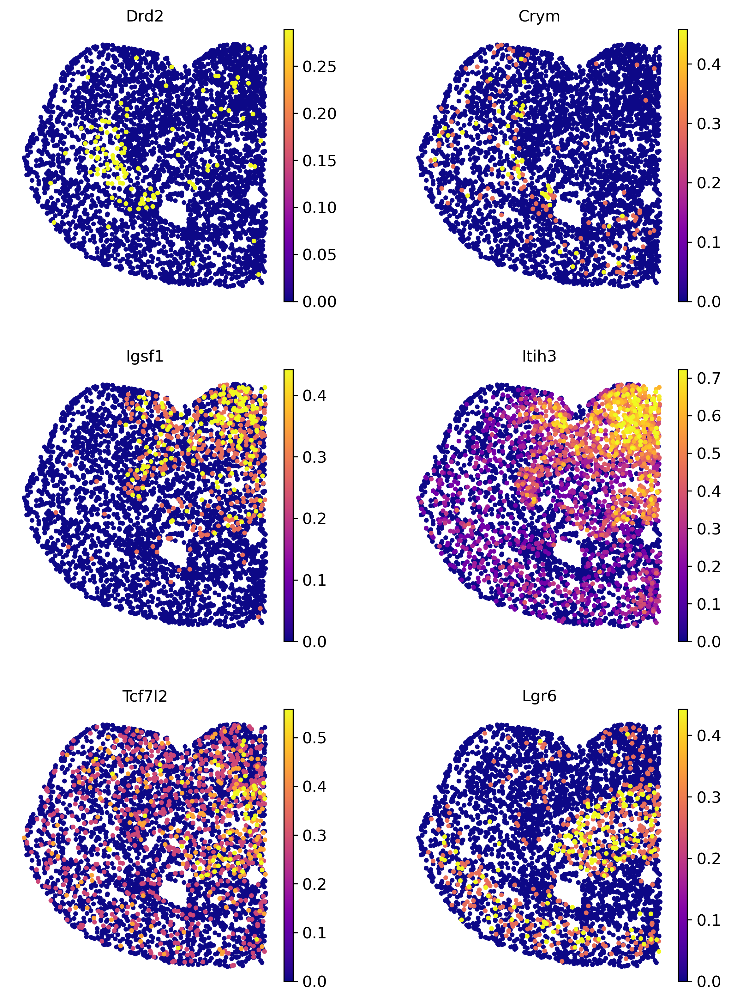

In [20]:
layer = "min_max_scaled"

for sample in adata.obs[setup.SAMPLE].unique().tolist()[:1]:
    sc.pl.spatial(
        adata_astro[adata_astro.obs[setup.SAMPLE] == sample],
        spot_size=100,
        color=["Drd2", "Crym", "Igsf1", "Itih3", "Tcf7l2", "Lgr6"],
        # color=["Drd2", "Crym"],
        # color=["Igsf1", "Itih3"],
        # color=['Tcf7l2','Lgr6'],
        ncols=2,
        frameon=False,
        # palette=cc.glasbey_light,
        cmap="plasma",
        # cmap=cc.cm["CET_CBL2"],
        show=False,
        use_raw=False,
        wspace=0.2,
        layer=layer,
        # title=layer,
        # vmax=0.9,
        vmax='p99',
        # sort_order=False,
    )
    # plt.savefig(
    #     os.path.join(figure_dir, "spatial_astro_genes_plasma99.svg"),
    #     bbox_inches="tight",
    #     dpi=500,
    # )
    # plt.savefig(
    #     os.path.join(figure_dir, "spatial_astro_genes_plasma99.png"),
    #     bbox_inches="tight",
    #     dpi=500,
    # )

In [16]:
adata.X[0].todense().max()

5.5919538

In [36]:
adata_astro.var_names.tolist()

['Htr7',
 'Gzmk',
 'Arhgap36',
 'Sema3c',
 'Rxrg',
 'Itga8',
 'Glp2r',
 'Ramp3',
 'Car12',
 'Chn2',
 'Endou',
 'Cnih3',
 'Esyt3',
 'Sox6',
 'Kit',
 'Colgalt2',
 'Synpo2',
 'Ntsr1',
 'Nxph3',
 'Brs3',
 'Ddc',
 'Fam43a',
 'Htr1f',
 'Slc5a5',
 'Lemd1',
 'Dcdc2a',
 'Serinc2',
 'Lamb3',
 'Ngf',
 'Trh',
 'Chat',
 'Gpr4',
 'Ngb',
 'Upk1b',
 'Ptger3',
 'Stk32b',
 'Gpr101',
 'Ucma',
 'Fndc1',
 'Sox14',
 'St18',
 'Il31ra',
 'Tcerg1l',
 'Aqp6',
 'Prkd1',
 'Rgs12',
 'Samd3',
 'Col26a1',
 'Moxd1',
 'S1pr1',
 'Tshz1',
 'Grik3',
 'Oprm1',
 '4930467D21Rik',
 'Adam18',
 'Irx6',
 'Lrp4',
 'Myo3b',
 'Dbh',
 'Onecut3',
 'Slc26a4',
 'Cd34',
 'Padi2',
 '2610028E06Rik',
 'Chrdl1',
 'D130009I18Rik',
 'Grm8',
 'Bves',
 'Pou4f2',
 'Pde3a',
 'Sox10',
 'Gda',
 'Esr1',
 'Epha10',
 'Trp73',
 'Alox8',
 'Klhdc8a',
 'Gpr149',
 'Nr2e1',
 '9330158H04Rik',
 'Crispld1',
 'Chrna2',
 'Rcn1',
 'Sec14l5',
 'Lcp1',
 'Ednra',
 '5830418P13Rik',
 'Serpina9',
 'Pou6f2',
 'Igfbp4',
 'Slc24a4',
 'Lhx4',
 'Hpse2',
 'Gnrh1',
 'Lypd6',

In [25]:
# Show the top genes for a module

module = 5

results = hs.results.join(hs.modules)
results = results.loc[results.Module == module]

module_genes = results.sort_values("Z", ascending=False).head(20).index.tolist()

results.sort_values("Z", ascending=False).head(20)

,C,Z,Pval,FDR,Module
Gene,,,,,
Itih3,0.602746,512.775215,0.000000e+00,0.000000e+00,5.0
Agt,0.682776,458.828350,0.000000e+00,0.000000e+00,5.0
Ucp2,0.237925,185.522859,0.000000e+00,0.000000e+00,5.0
Adcy8,0.223963,176.482077,0.000000e+00,0.000000e+00,5.0
Spon1,0.264280,158.883959,0.000000e+00,0.000000e+00,5.0
Gabbr2,0.192366,148.180845,0.000000e+00,0.000000e+00,5.0
B230323A14Rik,0.183567,145.306445,0.000000e+00,0.000000e+00,5.0
Sox1,0.170730,136.789545,0.000000e+00,0.000000e+00,5.0
Igsf1,0.177651,126.683245,0.000000e+00,0.000000e+00,5.0


In [26]:
results.sort_values("Z", ascending=False).head(20).index.tolist()

['Itih3',
 'Agt',
 'Ucp2',
 'Adcy8',
 'Spon1',
 'Gabbr2',
 'B230323A14Rik',
 'Sox1',
 'Igsf1',
 'Serpine2',
 'Ednrb',
 'Lhfp',
 'Plce1',
 'Ntrk3',
 'Vit',
 'Folh1',
 'Npas3',
 'Tox2',
 'Erbb4',
 'Prss35']